Importiamo le librerie:

In [31]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from sklearn import preprocessing

Carichiamo il dataset:

In [32]:
DATASET_PATH = 'datasets/csgo_round_snapshots.csv'

In [33]:
df = pd.read_csv(DATASET_PATH)

In [34]:
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


# Preprocessing
## Gestione dei valori nulli e duplicati

In [35]:
# Controlliamo se ci sono valori nulli
df.isnull().sum()

time_left                    0
ct_score                     0
t_score                      0
map                          0
bomb_planted                 0
                            ..
ct_grenade_molotovgrenade    0
t_grenade_molotovgrenade     0
ct_grenade_decoygrenade      0
t_grenade_decoygrenade       0
round_winner                 0
Length: 97, dtype: int64

In [36]:
# Controlliamo se ci sono duplicati
df.duplicated().sum()

np.int64(4962)

Durante l'analisi preliminare del dataset, abbiamo rilevato quanto segue:

- **Valori nulli**: Nessun valore nullo è presente nel dataset.
- **Duplicati**: Sono state trovate **4962** righe duplicate.

In effetti il dataset include snapshot presi durante i periodi di **time-out** nel gioco. Questo significa che, in alcuni casi, i dati catturati non rappresentano variazioni significative nel round e risultano identici a snapshot precedenti.

### Decisione Operativa
Poiché gli snapshot duplicati non forniscono informazioni aggiuntive o utili per il nostro modello, abbiamo deciso di **eliminarli** dal dataset.

L'eliminazione dei duplicati consentirà di:
1. Ridurre la dimensione del dataset.
2. Migliorare l'efficienza computazionale durante la fase di modellazione.
3. Assicurare che il modello di machine learning non apprenda pattern ridondanti o non significativi.

Questa operazione preserva l'integrità dei dati utili senza influire negativamente sulle analisi future.


In [37]:
df.drop_duplicates(inplace=True)

## Gestione delle colonne costanti
Effettuiamo un controllo sulle colonne per identificare quelle con un unico valore univoco. Queste colonne rappresentano feature che non apportano alcuna informazione significativa al modello di machine learning.

In [38]:
# Identifica le colonne con un solo valore univoco
unique_counts = df.nunique()

# Trova gli indici delle colonne con un solo valore univoco
constant_columns = unique_counts[unique_counts == 1].index

# Stampa gli indici delle colonne costanti
print("Colonne con un solo valore univoco:", constant_columns.tolist())

Colonne con un solo valore univoco: ['ct_weapon_bizon', 'ct_weapon_g3sg1', 't_weapon_m249', 'ct_weapon_negev', 'ct_weapon_r8revolver', 'ct_weapon_sawedoff']


<Axes: xlabel='ct_weapon_bizon', ylabel='count'>

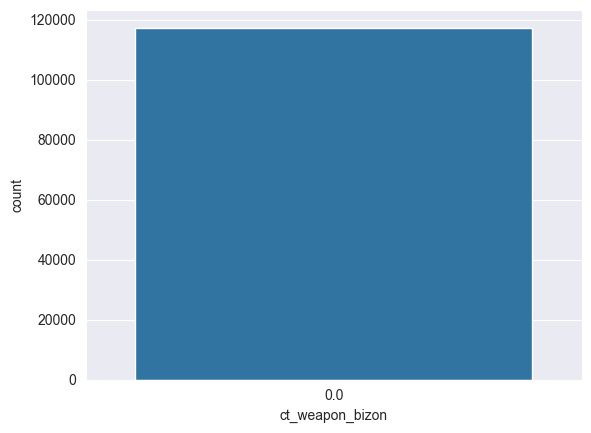

In [39]:
sns.countplot(x='ct_weapon_bizon', data=df)

Possiamo osservare che le colonne relative a equipaggiamenti non utilizzati (es. `ct_weapon_bizon`) contengono un solo valore univoco. Questo significa che nessun giocatore ha utilizzato quell'equipaggiamento durante i round catturati, di conseguenza queste colonne non forniscono alcuna informazione utile per il modello di machine learning.

Possiamo quindi procedere all'eliminazione di queste colonne dal dataset, in modo da ridurre la dimensionalità e migliorare le prestazioni del modello.

In [40]:
df.drop(columns=constant_columns, inplace=True)
df.head()

,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


## Gestione dei dati insufficienti
Il dataset contiene dati relativi a diversi round giocati su varie mappe, rappresentate dalla colonna `map`. Verifichiamo che ogni mappa abbia un numero sufficiente di dati per garantire un'analisi e una modellazione affidabili.


In [41]:
# Controlliamo se ci sono abbastanza dati per ogni mappa
map_counts = df['map'].value_counts()

# Visualizza il conteggio
print("Numero di dati per ogni mappa:")
print(map_counts)


Numero di dati per ogni mappa:
map
de_inferno     22982
de_dust2       21252
de_nuke        18078
de_mirage      17793
de_overpass    13474
de_train       12919
de_vertigo     10805
de_cache         145
Name: count, dtype: int64


Dall'analisi dei conteggi per ogni mappa, è emerso che la mappa `"de_cache"` contiene un numero di dati significativamente inferiore rispetto alle altre. Con solo **145 istanze**, rispetto alle migliaia di dati presenti per le altre mappe, `"de_cache"` è considerata sottorappresentata.
Questo accade perché probabilmente la mappa `"de_cache"` è stata reinserita (o al contrario, rimossa) nel pool ufficiale di mappe (composto da 7 mappe) giocate nei tornei professionistici di CS:GO, alla fine del periodo di acquisizione dei dati (o all'inizio).

Un numero di dati così limitato non consente al modello di apprendere pattern significativi relativi a questa mappa, inoltre la presenza di una mappa con pochi dati potrebbe sbilanciare il processo di apprendimento, introducendo rumore e riducendo l'accuratezza complessiva del modello.

Procediamo, quindi, alla rimozione di tutte le istanze associate alla mappa `"de_cache"` per garantire che il dataset sia bilanciato e rappresentativo delle mappe principali.

In [42]:
df = df[df['map'] != 'de_cache']

# Conferma la rimozione
print("Distribuzione aggiornata delle mappe:")
print(df['map'].value_counts())

Distribuzione aggiornata delle mappe:
map
de_inferno     22982
de_dust2       21252
de_nuke        18078
de_mirage      17793
de_overpass    13474
de_train       12919
de_vertigo     10805
Name: count, dtype: int64


## Correzione degli errori noti sul dataset
Nel dataset sono stati segnalati errori noti, relativi al conteggio delle armi per alcune categorie. In particolare, le seguenti variabili contengono valori che superano il limite massimo di 5 armi per giocatore, il che non è possibile secondo le regole del gioco:

- `t_weapon_cz75auto`
- `t_weapon_glock`
- `ct_weapon_usps`

Questi valori anomali indicano errori nei dati e potrebbero compromettere la qualità dell'analisi e la precisione del modello.

Procediamo quindi all'eliminazione delle relative righe, per migliorare l'integrità e l'affidabilità del dataset.

In [43]:
# Stampa il numero di righe che verranno eliminate
print("Numero di righe anomale:", len(df[(df['t_weapon_cz75auto'] > 5) | (df['t_weapon_glock'] > 5) | (df['ct_weapon_usps'] > 5)]))

df.drop(df[(df['t_weapon_cz75auto'] > 5) | (df['t_weapon_glock'] > 5) | (df['ct_weapon_usps'] > 5)].index, inplace=True)
df.head()

Numero di righe anomale: 22


,time_left,ct_score,t_score,map,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,...,t_grenade_flashbang,ct_grenade_smokegrenade,t_grenade_smokegrenade,ct_grenade_incendiarygrenade,t_grenade_incendiarygrenade,ct_grenade_molotovgrenade,t_grenade_molotovgrenade,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner
0,175.00,0.0,0.0,de_dust2,False,500.0,500.0,0.0,0.0,4000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
1,156.03,0.0,0.0,de_dust2,False,500.0,500.0,400.0,300.0,600.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
2,96.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
3,76.03,0.0,0.0,de_dust2,False,391.0,400.0,294.0,200.0,750.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT
4,174.97,1.0,0.0,de_dust2,False,500.0,500.0,192.0,0.0,18350.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,CT


## Codifica delle Variabili categoriche
Nel nostro dataset, alcune variabili sono categoriche e devono essere trasformate in un formato numerico prima di poter essere utilizzate nei modelli di machine learning. Questo processo, noto come **encoding**, permette di rappresentare valori testuali (es. `"de_dust2"` o `"True"`) come numeri, preservando le relazioni e le informazioni originali.

In questo caso, utilizzeremo tecniche di encoding diverse in base alle caratteristiche di ciascuna variabile categorica:

- **One-Hot Encoding** per la variabile `map`, perché é una variabile categorica nominale. In altre parole, non esiste un ordine intrinseco tra le categorie, quindi vogliamo rappresentare ciascuna mappa come una colonna binaria.
- **Label Encoding** per le variabili `bomb_planted` e `round_winner`, perché hanno solo due stati possibili.

In [44]:
# Crea un LabelEncoder separato per ogni variabile categorica a eccezione di 'map' dove utilizzeremo OneHotEncoder
map_encoder = preprocessing.OneHotEncoder(sparse_output=False)
bomb_encoder = preprocessing.LabelEncoder()
winner_encoder = preprocessing.LabelEncoder()

# One-Hot Encoding
map_encoded = map_encoder.fit_transform(df[['map']])
# Converti in DataFrame con i nomi delle colonne basati sulle categorie
map_encoded_df = pd.DataFrame(map_encoded, columns=map_encoder.get_feature_names_out(['map']))

# Reimpostiamo gli indici dopo aver precedentemente rimosso le righe dal DataFrame
df.reset_index(drop=True, inplace=True)
# Aggiungi le colonne One-Hot al DataFrame originale
df = pd.concat([df, map_encoded_df], axis=1)
# Ora 'map' è stata sostituita da colonne One-Hot quindi possiamo rimuovere la colonna originale
df.drop('map', axis=1, inplace=True)

df['bomb_planted'] = bomb_encoder.fit_transform(df['bomb_planted'])
df['round_winner'] = winner_encoder.fit_transform(df['round_winner'])

df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
0,175.00,0.0,0.0,0,500.0,500.0,0.0,0.0,4000.0,4000.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
1,156.03,0.0,0.0,0,500.0,500.0,400.0,300.0,600.0,650.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,174.97,1.0,0.0,0,500.0,500.0,192.0,0.0,18350.0,10750.0,...,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0


In [45]:
df.info()
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 117281 entries, 0 to 117280
Data columns (total 97 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   time_left                     117281 non-null  float64
 1   ct_score                      117281 non-null  float64
 2   t_score                       117281 non-null  float64
 3   bomb_planted                  117281 non-null  int64  
 4   ct_health                     117281 non-null  float64
 5   t_health                      117281 non-null  float64
 6   ct_armor                      117281 non-null  float64
 7   t_armor                       117281 non-null  float64
 8   ct_money                      117281 non-null  float64
 9   t_money                       117281 non-null  float64
 10  ct_helmets                    117281 non-null  float64
 11  t_helmets                     117281 non-null  float64
 12  ct_defuse_kits                117281 non-nul

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_grenade_decoygrenade,t_grenade_decoygrenade,round_winner,map_de_dust2,map_de_inferno,map_de_mirage,map_de_nuke,map_de_overpass,map_de_train,map_de_vertigo
count,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,...,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000,117281.000000
mean,94.641399,6.768743,6.829981,0.116583,408.507678,398.659587,317.759023,302.611693,9990.912424,11493.404729,...,0.027703,0.025136,0.510611,0.181155,0.195923,0.151661,0.154117,0.114886,0.110146,0.092112
std,53.222675,4.802416,4.833263,0.320924,133.854735,141.381686,170.321526,174.101162,11295.513293,12239.095163,...,0.169689,0.162316,0.499890,0.385148,0.396911,0.358694,0.361062,0.318886,0.313073,0.289185
min,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,54.910000,3.000000,3.000000,0.000000,335.000000,309.000000,195.000000,179.000000,1300.000000,1650.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,94.890000,6.000000,6.000000,0.000000,500.000000,500.000000,382.000000,353.000000,5900.000000,7650.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,114.960000,10.000000,11.000000,0.000000,500.000000,500.000000,487.000000,471.000000,15000.000000,18350.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,175.000000,32.000000,33.000000,1.000000,500.000000,500.000000,500.000000,500.000000,80000.000000,80000.000000,...,3.000000,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## Aggregazione delle armi per categoria
Nel dataset, le armi sono rappresentate da variabili separate per ogni tipologia, ad esempio:
- `t_weapon_ak47`
- `ct_weapon_awp`
- `ct_weapon_m4a4`

Questa granularità offre un alto livello di dettaglio, ma presenta alcuni problemi:
1. **Elevata dimensionalità**: Un numero elevato di variabili aumenta la complessità del modello e potrebbe introdurre rumore.
2. **Bassa utilità di alcune feature**: Molte armi sono poco utilizzate, e mantenerle separatamente non apporta valore informativo significativo.
3. **Rischio di overfitting**: Un modello addestrato su dati troppo specifici potrebbe non generalizzare bene su nuovi dati.
4. **Minore interpretabilità**: Un modello con troppe feature può essere difficile da interpretare.


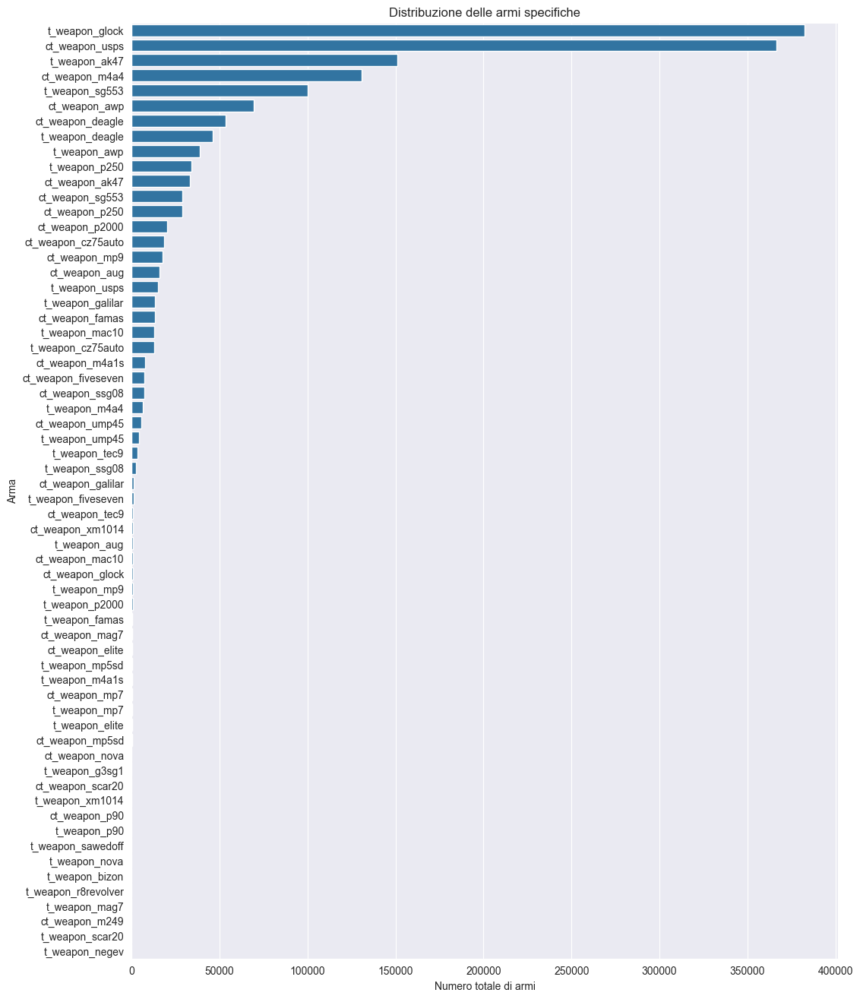

In [46]:
# Lista di colonne delle armi
weapon_columns = [col for col in df.columns if col.startswith('t_weapon') or col.startswith('ct_weapon')]

# Calcola la somma di ogni arma per ciascuna riga (giocatore)
weapon_sums = df[weapon_columns].sum()

# Ordina le armi in base alla frequenza di utilizzo
weapon_sums_sorted = weapon_sums.sort_values(ascending=False)

# Visualizza la distribuzione delle armi
plt.figure(figsize=(12, 16))
sns.barplot(x=weapon_sums_sorted.values, y=weapon_sums_sorted.index)
plt.title('Distribuzione delle armi specifiche')
plt.xlabel('Numero totale di armi')
plt.ylabel('Arma')
plt.show()

Come possiamo osservare, alcune armi appaiono come praticamente inutilizzate, ma questa è una caratteristica giustificata dal loro ruolo nel gioco. Ad esempio, `ct_weapon_glock` è l'arma di default per i Terroristi e non è acquistabile dai Contro-Terroristi, il che ne spiega il basso utilizzo tra le fila di quest'ultima squadra. Al contrario, armi come `t_weapon_negev`, pur essendo acquistabili da entrambe le squadre, sono raramente utilizzate. Questo comportamento può invece essere attribuito a fattori strategici, come la bassa efficacia in certe situazioni di gioco o il costo elevato rispetto ad altre armi più versatili.

Le armi verranno quindi raggruppato nelle seguenti categorie, per `ct` e `t`:
- **`rifle`**: Include fucili d'assalto come AK-47, M4A4, ecc.
- **`sniper`**: Include fucili di precisione come AWP, SSG 08, ecc.
- **`smg`**: Include mitragliette come MP9, UMP-45, ecc.
- **`default`**: Include armi di default ovvero USP-S, P2000 e Glock.
- **`pistol`**: Include pistole come Five-Seven, Deagle, ecc.
- **`heavy`**: Include armi pesanti come M249, Negev, ecc.
- **`shotgun`**: Include fucili a pompa come Nova, XM1014, ecc.

Verranno aggregate anche `grenade_incendiarygrenade` e `grenade_molotov` in `grenade_incendiary` in quanto rappresentano la stessa tipologia di granata. 

In [47]:
weapon_categories = {
    'ct_rifle': ['ct_weapon_ak47', 'ct_weapon_m4a4', 'ct_weapon_m4a1s', 'ct_weapon_aug', 'ct_weapon_famas', 'ct_weapon_galilar', 'ct_weapon_sg553'],
    't_rifle': ['t_weapon_ak47', 't_weapon_m4a4', 't_weapon_m4a1s', 't_weapon_aug', 't_weapon_famas', 't_weapon_galilar', 't_weapon_sg553'],
    'ct_sniper': ['ct_weapon_awp', 'ct_weapon_scar20', 'ct_weapon_ssg08'],
    't_sniper': ['t_weapon_awp', 't_weapon_scar20', 't_weapon_g3sg1', 't_weapon_ssg08'],
    'ct_smg': ['ct_weapon_mac10', 'ct_weapon_mp9', 'ct_weapon_mp7', 'ct_weapon_ump45', 'ct_weapon_p90', 'ct_weapon_mp5sd'],
    't_smg': ['t_weapon_mac10', 't_weapon_mp9', 't_weapon_mp7', 't_weapon_ump45', 't_weapon_p90', 't_weapon_bizon', 't_weapon_mp5sd'],
    'ct_default': ['ct_weapon_usps', 'ct_weapon_p2000', 'ct_weapon_glock'],
    't_default': ['t_weapon_usps', 't_weapon_p2000', 't_weapon_glock'],
    'ct_pistol': ['ct_weapon_p250', 'ct_weapon_fiveseven', 'ct_weapon_tec9', 'ct_weapon_cz75auto', 'ct_weapon_deagle', 'ct_weapon_elite'],
    't_pistol': ['t_weapon_p250', 't_weapon_fiveseven', 't_weapon_tec9', 't_weapon_cz75auto', 't_weapon_deagle', 't_weapon_r8revolver', 't_weapon_elite'],
    'ct_heavy': ['ct_weapon_m249'],
    't_heavy': ['t_weapon_negev'],
    'ct_shotgun': ['ct_weapon_nova', 'ct_weapon_xm1014', 'ct_weapon_mag7'],
    't_shotgun': ['t_weapon_nova', 't_weapon_xm1014', 't_weapon_mag7', 't_weapon_sawedoff']
}

incendiary_grenades_categories = {
    'ct_grenade_incendiary': ['ct_grenade_incendiarygrenade', 'ct_grenade_molotovgrenade'],
    't_grenade_incendiary': ['t_grenade_incendiarygrenade', 't_grenade_molotovgrenade']
}

# Creiamo nuove colonne aggregate per ciascuna categoria
for category, weapons in weapon_categories.items():
    df[f'{category}'] = df[weapons].sum(axis=1)
    
# Somma totale delle armi per ciascuna categoria
category_sums = df[[f'{category}' for category in weapon_categories]].sum()

# Ordinare le categorie in base alla somma totale
category_sums_sorted = category_sums.sort_values(ascending=False)

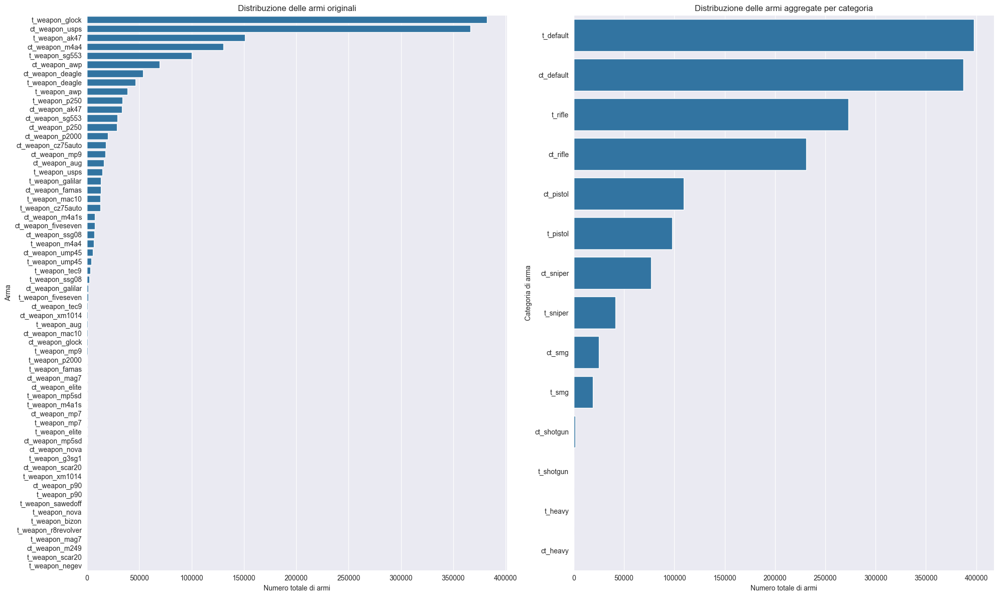

In [48]:
# Creiamo due subplots per confrontare le due distribuzioni
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 12))

# Grafico per la distribuzione delle armi originali
sns.barplot(x=weapon_sums_sorted.values, y=weapon_sums_sorted.index, ax=ax1)
ax1.set_title('Distribuzione delle armi originali')
ax1.set_xlabel('Numero totale di armi')
ax1.set_ylabel('Arma')

# Grafico per la distribuzione delle armi aggregate
sns.barplot(x=category_sums_sorted.values, y=category_sums_sorted.index, ax=ax2)
ax2.set_title('Distribuzione delle armi aggregate per categoria')
ax2.set_xlabel('Numero totale di armi')
ax2.set_ylabel('Categoria di arma')

plt.tight_layout()
plt.show()

Abbiamo ottenuto una rappresentazione più concisa e informativa delle armi, raggruppandole in categorie significative. Questo ci permette di mantenere informazioni rilevanti sulle preferenze dei giocatori per determinate tipologie di armi, riducendo al contempo la complessità del modello e migliorando la generalizzazione. Possiamo quindi procedere all'aggiornamento del dataset con le nuove colonne aggregate.

In [49]:
# Creazione delle nuove colonne aggregate per ciascuna categoria di armi
for category, weapons in weapon_categories.items():
    df[f'{category}'] = df[weapons].sum(axis=1)

for weapons in weapon_categories.values():
    df.drop(columns=weapons, inplace=True)
    
for category, grenades in incendiary_grenades_categories.items():
    df[f'{category}'] = df[grenades].sum(axis=1)

for grenades in incendiary_grenades_categories.values():
    df.drop(columns=grenades, inplace=True)

# Verifica delle modifiche
df.head()

,time_left,ct_score,t_score,bomb_planted,ct_health,t_health,ct_armor,t_armor,ct_money,t_money,...,ct_default,t_default,ct_pistol,t_pistol,ct_heavy,t_heavy,ct_shotgun,t_shotgun,ct_grenade_incendiary,t_grenade_incendiary
0,175.00,0.0,0.0,0,500.0,500.0,0.0,0.0,4000.0,4000.0,...,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,156.03,0.0,0.0,0,500.0,500.0,400.0,300.0,600.0,650.0,...,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,96.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,76.03,0.0,0.0,0,391.0,400.0,294.0,200.0,750.0,500.0,...,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,174.97,1.0,0.0,0,500.0,500.0,192.0,0.0,18350.0,10750.0,...,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [50]:
# Itera su ogni categoria di armi nel dizionario
print("Prima della correzione\n")
for category, weapons in weapon_categories.items():
    # Controlla se il numero di armi per la categoria è maggiore di 5
    invalid_rows = df[df[category] > 5]
    
    # Stampa il numero di righe con un valore maggiore di 5 per la categoria corrente
    print(f"Numero di righe con {category} > 5: {len(invalid_rows)}")
    
    # Se ci sono righe invalide, rimuovile
    if len(invalid_rows) > 0:
        df.drop(invalid_rows.index, inplace=True)

print("\nDopo la correzione")
for category, weapons in weapon_categories.items():
    # Controlla se il numero di armi per la categoria è maggiore di 5
    invalid_rows = df[df[category] > 5]
    
    # Stampa il numero di righe con un valore maggiore di 5 per la categoria corrente
    print(f"Numero di righe con {category} > 5: {len(invalid_rows)}")

Prima della correzione

Numero di righe con ct_rifle > 5: 0
Numero di righe con t_rifle > 5: 0
Numero di righe con ct_sniper > 5: 0
Numero di righe con t_sniper > 5: 0
Numero di righe con ct_smg > 5: 0
Numero di righe con t_smg > 5: 0
Numero di righe con ct_default > 5: 15
Numero di righe con t_default > 5: 20
Numero di righe con ct_pistol > 5: 0
Numero di righe con t_pistol > 5: 0
Numero di righe con ct_heavy > 5: 0
Numero di righe con t_heavy > 5: 0
Numero di righe con ct_shotgun > 5: 0
Numero di righe con t_shotgun > 5: 0

Dopo la correzione
Numero di righe con ct_rifle > 5: 0
Numero di righe con t_rifle > 5: 0
Numero di righe con ct_sniper > 5: 0
Numero di righe con t_sniper > 5: 0
Numero di righe con ct_smg > 5: 0
Numero di righe con t_smg > 5: 0
Numero di righe con ct_default > 5: 0
Numero di righe con t_default > 5: 0
Numero di righe con ct_pistol > 5: 0
Numero di righe con t_pistol > 5: 0
Numero di righe con ct_heavy > 5: 0
Numero di righe con t_heavy > 5: 0
Numero di righe con

In [51]:
# Facciamo lo stesso controllo per le granate
grenade_categories = [
    'ct_grenade_hegrenade', 'ct_grenade_flashbang', 'ct_grenade_smokegrenade', 'ct_grenade_incendiary', 'ct_grenade_decoygrenade',
    't_grenade_hegrenade', 't_grenade_flashbang', 't_grenade_smokegrenade', 't_grenade_decoygrenade', 't_grenade_incendiary'
]

# Itera su ogni categoria di granata
for grenade_col in grenade_categories:
    invalid_rows = df[df[grenade_col] > 5]
    
    print(f"Numero di righe con {grenade_col} > 5: {len(invalid_rows)}")

Numero di righe con ct_grenade_hegrenade > 5: 0
Numero di righe con ct_grenade_flashbang > 5: 0
Numero di righe con ct_grenade_smokegrenade > 5: 0
Numero di righe con ct_grenade_incendiary > 5: 0
Numero di righe con ct_grenade_decoygrenade > 5: 0
Numero di righe con t_grenade_hegrenade > 5: 0
Numero di righe con t_grenade_flashbang > 5: 0
Numero di righe con t_grenade_smokegrenade > 5: 0
Numero di righe con t_grenade_decoygrenade > 5: 0
Numero di righe con t_grenade_incendiary > 5: 0


# Analisi Esplorativa

Vediamo innanzitutto la distribuzione delle mappe giocate dai giocatori professionisti.

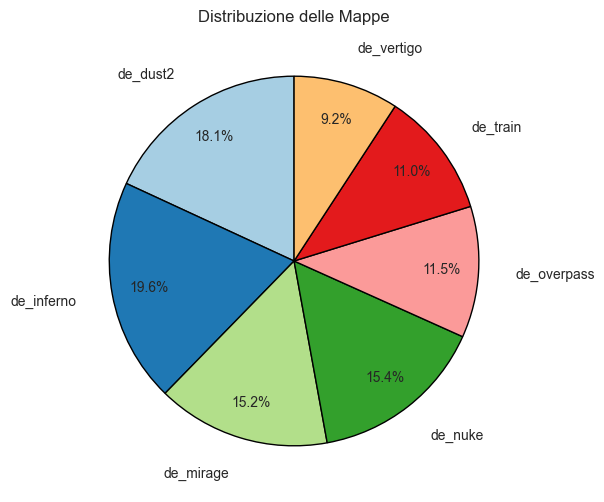

In [52]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Calcolare le occorrenze di ciascuna mappa
map_counts = df[map_columns].sum()

# Rinominare le mappe rimuovendo il prefisso "map_"
map_counts.index = map_counts.index.str.replace('map_', '')

# Creare il grafico a torta
plt.figure(figsize=(12, 6))
map_counts.plot.pie(
    autopct='%1.1f%%',
    startangle=90,
    colors=plt.cm.Paired.colors,
    labeldistance=1.2,
    wedgeprops={'edgecolor': 'black'},
    pctdistance=0.8
)
plt.title('Distribuzione delle Mappe')
plt.ylabel('')  # Toglie il label y
plt.show()

La mappa più giocata é de_inferno (19.6%), seguita da de_dust2 (18.1%) e de_nuke (15.4%).
La mappa meno giocata é de_vertigo (9.2%).

Analizziamo la situazione dei round vinti dai Terroristi e dai Contro-Terroristi in de_inferno.

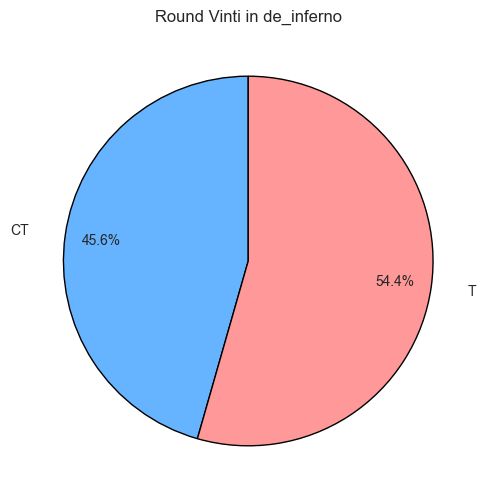

In [53]:
# Definisci i colori per CT e T
color_ct = '#66b3ff'
color_t = '#ff9999'

# Filtra i dati per la mappa 'de_inferno'
inferno_df = df[df['map_de_inferno'] == 1]

# Calcola la distribuzione di round_winner
round_winner_counts = inferno_df['round_winner'].value_counts().sort_index()  # Ordina per 0 e 1

# Disegna il grafico a torta
plt.figure(figsize=(6, 6))
round_winner_counts.plot.pie(
    autopct='%1.1f%%',  # Percentuali per ciascuna fetta
    startangle=90,  # Imposta l'angolo di inizio
    colors=[color_ct, color_t],  # Colori per CT (0) e T (1)
    labels=['CT', 'T'],  # Etichette manuali: CT per 0 e T per 1
    labeldistance=1.2,  # Distanza tra l'etichetta e il centro
    wedgeprops={'edgecolor': 'black'},  # Bordo alle fette
    pctdistance=0.8  # Posizione delle percentuali
)
plt.title('Round Vinti in de_inferno')  # Titolo del grafico
plt.ylabel('')  # Rimuove il label sull'asse Y
plt.show()  # Mostra il grafico

Pare che su de_inferno i Terroristi abbiano un leggero vantaggio rispetto ai Contro-Terroristi.

Vediamo ora come l'economia influisce sui round vinti.

In [54]:
# 1. Calcola il numero di round vinti dalla squadra con il maggior numero di soldi
rounds_won_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 0)],  # CT ha più soldi e vince
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 1)]   # T ha più soldi e vince
])

# 2. Calcola il numero di round persi dalla squadra con il maggior numero di soldi
rounds_lost_by_max_money_team = pd.concat([
    df[(df['ct_money'] > df['t_money']) & (df['round_winner'] == 1)],  # CT ha più soldi e perde
    df[(df['t_money'] > df['ct_money']) & (df['round_winner'] == 0)]   # T ha più soldi e perde
])

# 3. Calcola la percentuale di round vinti
total_rounds = len(df)
rounds_won = len(rounds_won_by_max_money_team)
percent_rounds_won = (rounds_won / total_rounds) * 100

# 4. Calcola la percentuale di round persi
rounds_lost = len(rounds_lost_by_max_money_team)
percent_rounds_lost = (rounds_lost / total_rounds) * 100

# Mostra i risultati
print(f"Percentuale di round vinti dalla squadra con il maggior numero di soldi: {percent_rounds_won:.1f}%")
print(f"Percentuale di round persi dalla squadra con il maggior numero di soldi: {percent_rounds_lost:.1f}%")

Percentuale di round vinti dalla squadra con il maggior numero di soldi: 60.2%
Percentuale di round persi dalla squadra con il maggior numero di soldi: 38.1%


Quindi, la squadra con piú soldi vince tendenzialmente piú round rispetto a quella con meno soldi.

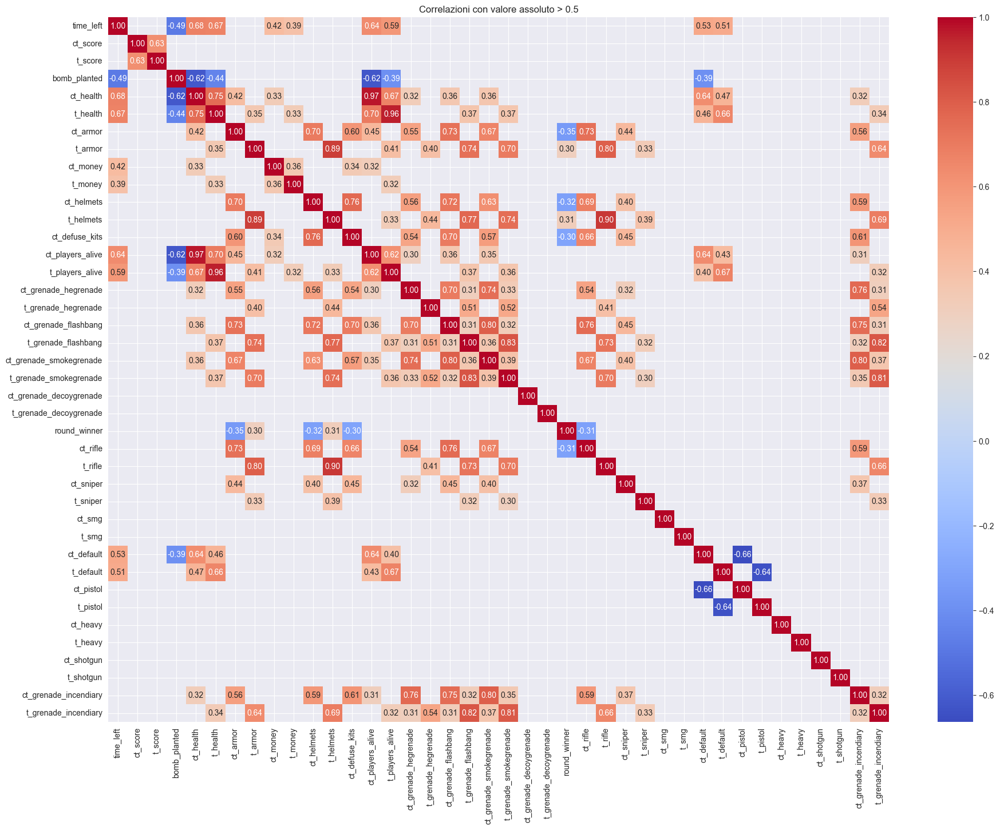

In [61]:
# Calcolare la matrice di correlazione
correlation_matrix = df.corr()

# Rimuovere le colonne che iniziano con "map_"
correlation_matrix = correlation_matrix.drop(columns=[col for col in correlation_matrix.columns if col.startswith('map_')], 
                                              index=[col for col in correlation_matrix.columns if col.startswith('map_')])

# Filtrare le correlazioni con valore assoluto superiore a 0.5
high_corr = correlation_matrix[correlation_matrix.abs() > 0.3]

# Creiamo una heatmap per visualizzare solo le correlazioni forti
plt.figure(figsize=(22, 16))
sns.heatmap(high_corr, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title("Correlazioni con valore assoluto > 0.3")
plt.show()

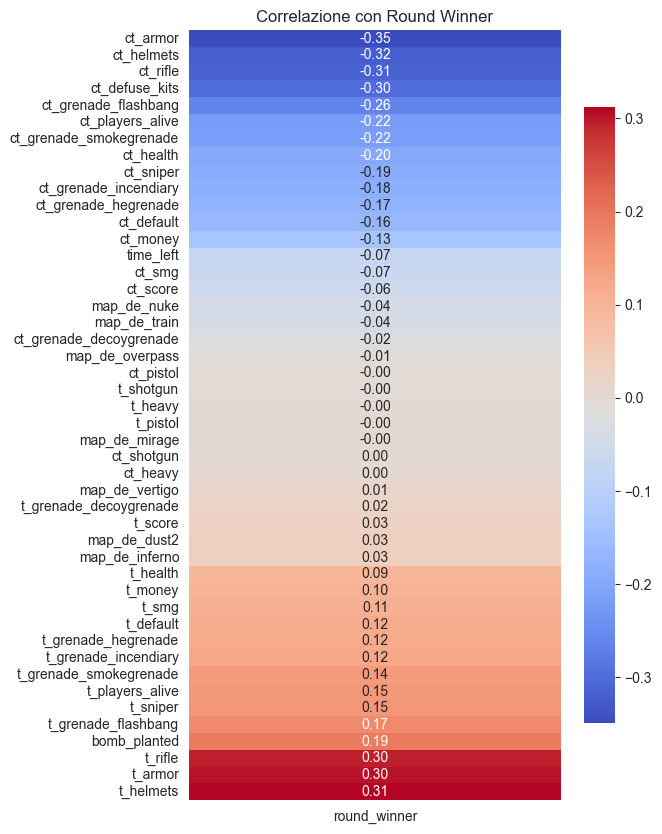

In [65]:
# Calcola le correlazioni tra 'round_winner' e tutte le altre colonne numeriche
correlation = df.corr()  # Calcola la matrice di correlazione
round_winner_corr = correlation['round_winner'].drop('round_winner')# Prendi solo la colonna 'round_winner' e rimuovi se stessa

# Ordina i valori in ordine crescente
round_winner_corr_sorted = round_winner_corr.sort_values()

plt.figure(figsize=(6, 10))
sns.heatmap(
    round_winner_corr_sorted.to_frame(),  # Converti in dataframe
    annot=True,
    fmt=".2f",
    cmap="coolwarm",
    cbar=True,
    cbar_kws={"shrink": 0.8},  # Riduce la dimensione della barra di colore per evitare sovrapposizioni
    xticklabels=True,
    yticklabels=True
)
plt.title("Correlazione con Round Winner")
plt.show()

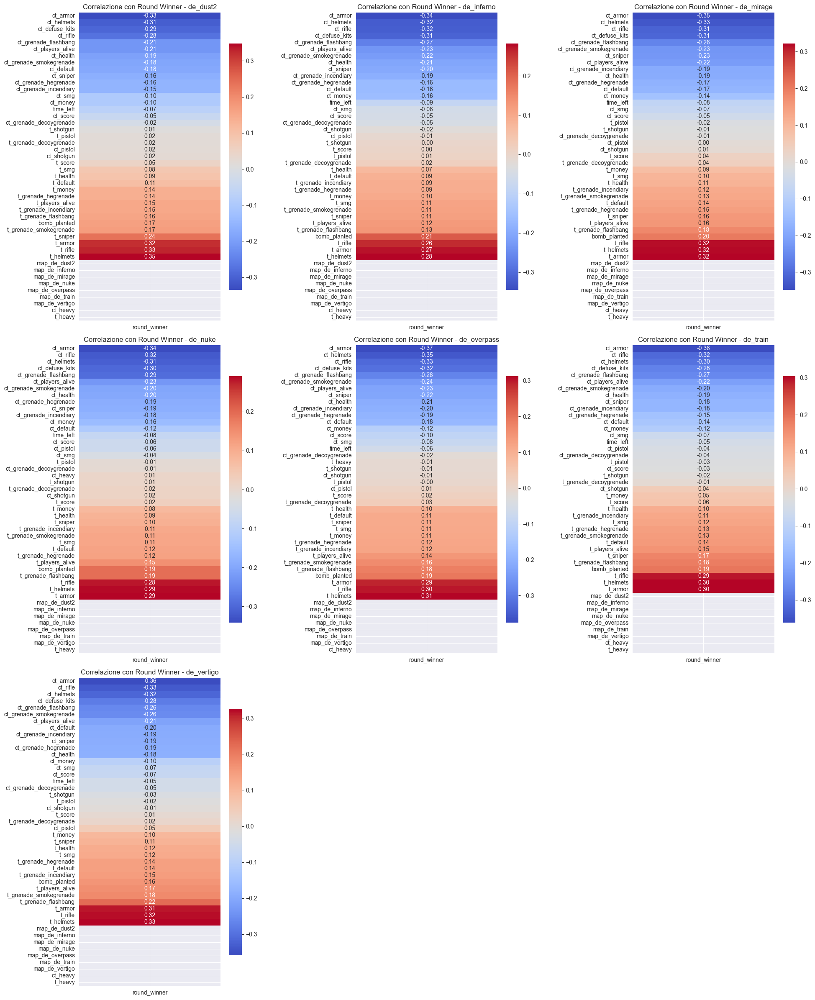

In [57]:
# Ottieni le colonne One-Hot delle mappe
map_columns = [col for col in df.columns if col.startswith('map_')]

# Calcolare il numero di colonne per la griglia
n_cols = 3 
n_rows = (len(map_columns) // n_cols) + (1 if len(map_columns) % n_cols != 0 else 0)

# Crea la figura e i subplot
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 8 * n_rows))
axes = axes.flatten()

# Itera su ogni colonna One-Hot e calcola le correlazioni
for i, map_col in enumerate(map_columns):
    # Filtra il dataset per la mappa corrente (dove la colonna della mappa è 1)
    df_map = df[df[map_col] == 1]
    
    # Calcola la matrice di correlazione per questa mappa
    correlation = df_map.corr()
    
    # Prendi solo la colonna 'round_winner'
    round_winner_corr = correlation['round_winner'].drop('round_winner').sort_values()
    
    # Plotta la heatmap
    sns.heatmap(
        round_winner_corr.to_frame(),
        annot=True,
        fmt=".2f",
        cmap="coolwarm",
        cbar=True,
        ax=axes[i],
        cbar_kws={"shrink": 0.8},  # Riduce la dimensione della barra di colore per evitare sovrapposizioni
        xticklabels=True,
        yticklabels=True
    )
    
    # Imposta il titolo per ciascun grafico
    axes[i].set_title(f"Correlazione con Round Winner - {map_col.replace('map_', '')}")
    
# Nascondi eventuali assi vuoti se ci sono meno heatmap di quelle previste
for j in range(len(map_columns), len(axes)):
    axes[j].axis('off')

plt.subplots_adjust(wspace=30, hspace=1)
plt.tight_layout()
plt.show()

In [66]:
fig = px.histogram(df,"time_left")
fig.show()

fig = px.histogram(df,"ct_score")
fig.show()

fig = px.histogram(df,"t_score")
fig.show()

fig = px.histogram(df,"ct_health")
fig.show()

fig = px.histogram(df,"t_health")
fig.show()

fig = px.histogram(df,"ct_armor")
fig.show()

fig = px.histogram(df,"ct_money")
fig.show()

fig = px.histogram(df,"t_grenade_flashbang")
fig.show()

fig = px.histogram(df,"ct_grenade_smokegrenade")
fig.show()

fig = px.histogram(df,"ct_grenade_incendiary")
fig.show()

fig = px.histogram(df,"ct_default")
fig.show()